# ** Taller 2 - Técnicas de regresión**
John Vicente Moreno Triviño – 202210162

MINE-4101: Applied Data Science  
Universidad de los Andes  
  
**Dataset:** Indicadores por país, recolectados por Gapminder.  [[dataset](https://drive.google.com/file/d/1zsFX4PUehK_rmLtP-1hqPnSo86VMHDAm/view)]


# **0. Importación de librerías**

In [1]:
!pip install --upgrade scikit-learn pandas seaborn ydata_profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 83.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 91.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 33.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 34.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 341.8/341.8 kB 31.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 114.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 13.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 53.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 36.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 106.3 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=c11bb4f7ccca540eda392ea2214a50af613266c714c8436aa8bb72229decdb

In [2]:
import pickle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import calendar
import sklearn
import ydata_profiling
from scipy.stats import chi2_contingency
from sklearn.compose import ColumnTransformer, make_column_selector
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.linear_model import Lasso, LinearRegression, Ridge
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.pipeline import FeatureUnion, make_pipeline, make_union
from sklearn.preprocessing import (
    MinMaxScaler,
    OneHotEncoder,
    OrdinalEncoder,
    PolynomialFeatures,
    QuantileTransformer,
    StandardScaler,
)

# Pandas configuration for extending the number of columns and rows to show
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)

%matplotlib inline


In [3]:
pd.__version__, sklearn.__version__

('2.0.3', '1.3.1')

# **1. Entendimiento del negocio**

El Banco Mundial tiene como uno de sus objetivos misionales prestar apoyo financiero a países en desarrollo para la ejecución de proyectos que permitan mejorar las condiciones de vida de la población y fortalecer el aparato socioeconómico. Sin embargo, una de sus mayores preocupaciones es hacer lo posible para que el dinero sea invertido de forma eficiente en los países receptores, al tiempo que se garantiza la devolución de estos préstamos.

Por otra parte, los países en desarrollo saben que mostrar estabilidad y capacidad de pago facilitará que el Banco Mundial les asigne fondos para invertir en sus proyectos, al tiempo que deben demostrar que estos fondos se usarán de manera sabía y eficiente. Adicional a esto, tanto el Banco Mundial como los países en desarrollo son conscientes de que el PIB Per Capita es uno de los mejores indicadores que predicen la estabilidad social y económica de un país.

Por lo anterior, es necesario encontrar cuáles son las principales variables que tienen una mayor relación con el PIB Per Capita, de modo que los gobiernos de estos países puedan enfocar sus políticas públicas en la mejora de las áreas que resulten claves.

**Objetivos de negocio:**
1. Generar recomendaciones, basadas en datos, sobre las políticas públicas que los gobiernos de los países en desarrollo deberían implementar para demostrar que son economías estables, enfocadas en el desarrollo sostenible y con la capacidad de pago para recibir fondos suficientes por parte del Banco Mundial.

2. Ayudar al Banco Mundial a entender cuáles son las variables que mejor se corelacionan con el PIB Per Capita de una nación, de modo que sea posible diseñar políticas de préstamos mejor informadas, enfocándose en sectores clave para cada país.

**Objetivos del proceso de análisis de datos con ML:**

1. Utilizar algoritmos de regresión lineal multivariable para entender la relación entre el PIB Per Capita de un país y otras variables socioeconómicas

2. Entrenar y validar un modelo de regresión lineal de Machine Learning, comprendiendo el proceso de ajuste del modelo y la interpretación de sus coeficientes.

# **2. Entendimiento de los datos**

A continuación se cargan y verifican los datos:

In [4]:
# Loading the CSV file as dataframe
df = pd.read_csv("./gapminder_final.csv")

In [5]:
# Showing dataframe dimensions
df.shape

(178, 16)

**Tipo de datos:**

In [6]:
# Showing column types
df.dtypes

country                  object
incomeperperson         float64
alcconsumption          float64
armedforcesrate         float64
breastcancerper100th    float64
co2emissions            float64
femaleemployrate        float64
hivrate                 float64
internetuserate         float64
lifeexpectancy          float64
oilperperson            float64
polityscore             float64
relectricperperson      float64
suicideper100th         float64
employrate              float64
urbanrate               float64
dtype: object

In [7]:
df.sample(10) # Showing a sample of n rows

,country,incomeperperson,alcconsumption,armedforcesrate,breastcancerper100th,co2emissions,femaleemployrate,hivrate,internetuserate,lifeexpectancy,oilperperson,polityscore,relectricperperson,suicideper100th,employrate,urbanrate
147,Zambia,432.226337,3.56,0.341335,13.0,1.320257e+08,53.500000,13.5,10.124986,49.025,NaN,7.0,168.623030,12.019036,61.000000,35.42
141,United Kingdom,28033.489280,13.24,0.508018,87.2,7.252425e+10,53.099998,0.2,84.731705,80.170,1.188028,10.0,1933.945615,6.014659,59.299999,89.94
45,Angola,1381.004268,5.57,1.461329,23.1,2.483580e+08,69.400002,2.0,9.999954,51.093,NaN,-2.0,172.999227,14.554677,75.699997,56.70
121,New Zealand,14778.163930,9.99,0.389157,91.9,1.321661e+09,58.299999,0.1,83.002584,80.654,1.579621,10.0,2993.092660,12.179760,65.000000,86.56
32,Switzerland,37662.751250,11.41,0.524220,81.7,2.406741e+09,57.000000,0.4,82.166660,82.338,1.487412,10.0,2361.033336,13.239810,64.300003,73.48
86,Zimbabwe,320.771890,4.96,1.032785,19.0,5.902197e+08,58.099998,14.3,11.500415,51.384,NaN,1.0,297.883200,13.905267,66.800003,37.34
43,Mozambique,389.763634,2.27,0.102269,3.9,1.070960e+08,82.199997,11.5,4.170136,50.239,NaN,5.0,31.386838,10.550375,77.000000,36.84
69,Malta,11066.784140,4.10,1.144319,76.1,7.378433e+07,30.100000,0.1,63.077993,79.634,NaN,NaN,1598.673959,4.551121,46.799999,94.26
97,Luxembourg,52301.587180,12.84,0.731336,82.5,5.920127e+08,45.900002,0.3,90.079527,79.963,NaN,NaN,1566.106139,12.405918,53.500000,82.44
120,Malaysia,5184.709328,0.87,1.142127,30.8,2.670950e+09,43.099998,0.5,56.300034,74.221,0.890813,6.0,767.970324,8.211067,60.500000,70.36


**2.1 Análisis univariado**

Para el análisis de los datos se utilizará en primer lugar la herramienta ProfileReport. Con esta herramienta será posible evaluar la completitud y la consistencia de los datos, tener una vista de la distribución de cada variable y un mapa de calor con las correlaciones entre variables (este se usará para el análisis bivariado). De este modo, se han extraído las siguientes conclusiones sobre los datos:

**Dataset:**

-Se cuenta con un dataset de 178x16. La primera de las columnas representa el país (tipo de variable "String"), mientras que las restantes 15 columnas son variables numericas (Float) con diferentes indicadores socioeconómicos de cada país.
-Existen 12 registros duplicados, los cuales se eliminarán en el proceso de preparación de datos.

Ahora, en cuanto a cada una de las variables tenemos lo siguiente:

**-country:**

Esta variable constituye un identificador único (string) que representa al país en cuestión.

**-incomeperperson:**

Esta es la variable que será objetivo de la regresión (variable Y). Representa el PIB per Cápita de los países para 2010, es decir, es el PIB total del país dividido entre su población total.

Es importante mencionar aquí que el PIB per Cápita es uno de los indicadores más usados para estimar la calidad de vida y el bienestar general de los habitantes de un país. Esto porque un país puede tener un PIB muy grande (como China o India) pero al mismo tiempo sus habitantes ser muy pobres: al ser tantas personas, por más grande que sea el PIB total los recursos no van a alcanzar para todos. Por otra parte, hay países con un PIB relativamente pequeño, como Singapur o Nueva Zelanda, pero que al normalizar como PIB per Cápita, resulta en que sus habitantes disponen de grandes ingresos por cabeza y un alto nivel de vida.

En cuanto a la distribución de esta variable, en el reporte que se generó con ProfileReport es posible ver que la gran mayoría de paises (75%) contaban con un PIB per Cápita menor a USD 10.000 para 2010. Es decir, la mayoría de países del mundo se pueden considerar como subdesarrollados.

**-alcconsumption:**

Representa el consumo de alcohol puro per cápita, en litros, para personas mayores de 15 años. De su distribución se observa que los países se repartien de manera más o menos uniforme entre aquellos con consumo de alcohol bajo, intermedios y altos. En general, no se esperaría que esta variable sea significativa para predecir el PIB per Cápita. Esto porque hay países ricos, como Alemania o Australia, donde el consumo de alcohol es muy alto; mientras que existen otros países también de altos ingresos, como Emiratos Árabes o Qatar, donde el consumo de alcohol es casi cero por temas religiosos.

**-armedforcesrate:**

Representa el porcentaje de la fuerza laboral que pertenece a las fuerzas armadas. De la distribución se observa que para la mayoría de países (78%) este porcentaje es menor al 2%, siendo superior para países que se encuentran en conflictos bélicos, dictaduras duras, países de oriente medio y africanos. En general, no se esperaría que este indicador sea muy relevante en la regresión.

**-breastcancerper100th:**

Número de nuevos casos de cancer de seno durante 2002 por cada 100.000 mujeres. La distribución muestra que son más los países donde este indicador tuvo un valor menor a 40, pero no es despreciable el número de países donde este indicador puntua entre 40 y 90. A priori, se esperaría que esta variable tenga una correlación negativa con la riqueza per cápita de un país.

**-co2emissions:**

Representa el acumulado total de emisiones de CO2 por país a 2006, contabilizado desde 1751. Esta variable tiene dos problemas. El primero, es que según la distribución de los datos existen outliers correspondientes a las economías más grandes e industrializadas, quienes son, y de lejos, los países que más han contaminado historicamente.

Sin embargo, y aquí viene el segundo problema, este indicador no es per cápita, sino agregado total por país, por lo que no es consistente con la variable a predecir. Por ejemplo, el segundo país que más ha contaminado en toda la historia es China, pero su población también es muy grande, por lo que las emisiones per cápita no serían tan altas como las de países como USA o UK.

Una primera idea entonces es no tener en cuenta este indicador, idea que se ve reforzada con el hecho de que se cuenta con otros  dos indicadores relacionados con el consumo energético de los países: el consumo eléctrico y el comsumo de petroleo, ambos por persona. Estos dos indicadores pueden ser más indicados para la regresión.

**-femaleemployrate:**

Porcentaje de la población feminina que ha estado empleada durante 2007. Puede observarse que esta variable tiene una distribución aproximadamente normal (en campana), centrada alrededor del 50%. A priori, se considera que esta variable no debería tener gran incidencia en la regresión, puesto que existen países muy conservadores pero con altos ingresos (medio oriente por ejemplo) donde las mujeres casi no trabajan porque sus familias no lo permiten, mientras que en regiones tan diferentes como Europa y Latinoamérica se tiene una alta participación de las mujeres en el mercado laboral.

**-hivrate:**

Porcentaje de personas entre 15 y 49 años infectadas con VIH para 2009. De la distribución se observa que el 73% de los países tienen tasas de infección menores al 2%. Este es uno de los indicadores que sí se espera sea muy influyente en la regresión, con una correlación negativa, puesto que refleja el estado de la política sanitaria de un país, y como se sabe, entre más rico sea un país, probablemente mejores serán sus servicios de prevención y atención médica.

**-internetuserate:**

Porcentaje de personas con acceso a Internet para 2010. De la distribución se observa que en un 43% de los países, menos del 20% de la población contaba con acceso a Internet para ese año; en el 35% de los países, entre el 20% y el 60% de la población contaba con Internet; y solo en el 22% de los países más del 60% de la población contaba con acceso a Internet.

Dicho de otra forma, el acceso a Internet era una especie de lujo hacia 2010. También se espera que esta variable sea importante para la regresión.

**-lifeexpectancy:**

Expectativa de vida al nacer para 2011. Para el 61% de los países, esta expectativa de vida es mayor a 70 años según la distribución de los datos. Esta es otra de las variables que sea significativa en la regresión.

**-oilperperson:**

Consumo per cápita de petroleo (toneladas) por persona para 2010. Esta variable tiene muchos campos vacíos por lo que no es conveniente hacer comentarios basados en su distribución. De hecho, a priori, se consideraría no tenerla en cuenta en la regresión.

**-polityscore:**

Indicador sobre el nivel de democracia en un país para 2009. De la distribución puede verse que, mal que bien, en el mundo priman los sistemas más o menos democráticos sobre los autoritarios. Específicamente, el 58% de los países tienen calificaciones entre 5 y 10 en este indicador (esto teniendo en cuenta que la calificación mínima es -10).

**-relectricperperson:**

Consumo de energía eléctrica a nivel residencial por persona (KW-H) para 2008. De su distribución es posible decir que en el 56% de lo países las personas tienen bajo consumo energético en sus hogares. Dicho de otra forma, el mundo está dividido entre los países que consumen mucha electricidad a nivel residencial y los que no. Y en el caso de estos últimos, no se debe a que sean ahorradores o ambientalmente conscientes, sino más bien a que sus habitantes no han podido suplir ciertas necesidades básicas a nivel de tener disponibles elementos como computadores, lavadoras, neveras, televisores, etc.

Siendo así, a priori se espera que esta variable sea relevante para la regresión. A mayor desarrollo económico, más consumo de energía eléctrica debería haber.

**-suicideper100th:**

Tasa de sucidios por cada 100 mil habitantes. Su distribución tiene una forma aproximada de campana, centrada alrededor de un valor de 9. Sin embargo, se trata de una campana alargada hacia la izquierda, lo que muestra que existen países con tasas mucho más altas de suicidios que el resto. A priori, no se esperaría que esta variable sea de todo significativa, pero el análisis de datos tendrá la última palabra. Sin embargo, existen casos de países con altos niveles de desarrollo, como Japón, que no obstante tienen tasas elevadas de suicidios.

**-employrate:**

POrcentaje total de la población mayor de 15 años que fungió estuvo ocupada a nivel laboral en 2007. Su distribución muestra una forma de campana, un poco sesgada hacia la izquierda y con una mediana de 58%. A priori, es posible pensar que esta variable sí va a tener influencia en la predicción del PIB per Cápita, entre más personas trabajen, mayor será la producción de un país.

**-urbanrate:**

Porcentaje de población urbana sobre la población total. La distribución de esta variable, sorprendentemente, tiende a ser más o menos homogenena entre 0 y 100%, significando esto que aún en la actualidad existen países preminentemente rurales versus países totalmente urbanizados. Sin embargo, la gráfica de distribución muestra cierta prevalencia de los países con poblaciones urbanas entre el 60% y el 80%.

Esta es otra de las variables que se espera sean determinantes en la regresión, puesto que las economías más avanzadas se caracterizan por su alto grado de urbanización, el cual va de la mano de la industrialización y las economías basadas en servicios profesionales.




In [25]:
ydata_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**2.1 Análisis bivariado**

El análisis bivariado se basará en el mapa de calor de correlaciones generado por ProfileReport y las siguientes gráficas de dispersión que comparan todas las variables en pares.

Del mapa de dispersión resulta muy interesante observar que las siguientes variables tienen una correlación importante (negativa o positiva) con el PIB per Cápita. Dado que el comportamiento de estas variables ya se explicó anteriormente, se realizará un breve análisis del top 6 de correlaciones observadas.

**Top 6 indicadores:**

**breastcancerper100TH:** resulta muy sorpresivo que esta variable tenga una correlación positiva con el PIB per Cápita de un país. A primera vista, esto no tenddría sentido. Sin embargo, haciendo una averiguación rápida en Google, resulta ser que en los países desarrollados están más extendidos los análisis de diagnóstico de cancer de seno, lo que facilita su tratamiento posterior. Entonces, no es que las mujeres de países desarrollados se enfermen más, simplemente es que en los países pobres las mujeres no tienen acceso a diagnósticos eficaces, y muchas veces mueren antes de saber que tuvieron esta enfermedad.

**HIVrate:** como era de esperarse, este indicador se relaciona negativamente con la riqueza de un país.

**Internetuserate**: como era de esperarse, entre más rico un país, más acceso a internet tienen sus ciudadanos.

**lifeexpectancy**: no es sorpresa que los países con mayores ingresos por persona tengan esperanzas de vida más altas.

**relectricperperson**: tampoco es sorpresa que entre mayor desarrollo económico, haya más consumo energético a nivel residencial.

**urbanrate**: para finalizar, y tal como se esperaba, la tasa de habitantes de zonas urbanas esta correlacionada con el PIB per Cápita.

Las siguientes gráficas ayudan a confirmar visualmente lo aquí expuesto.

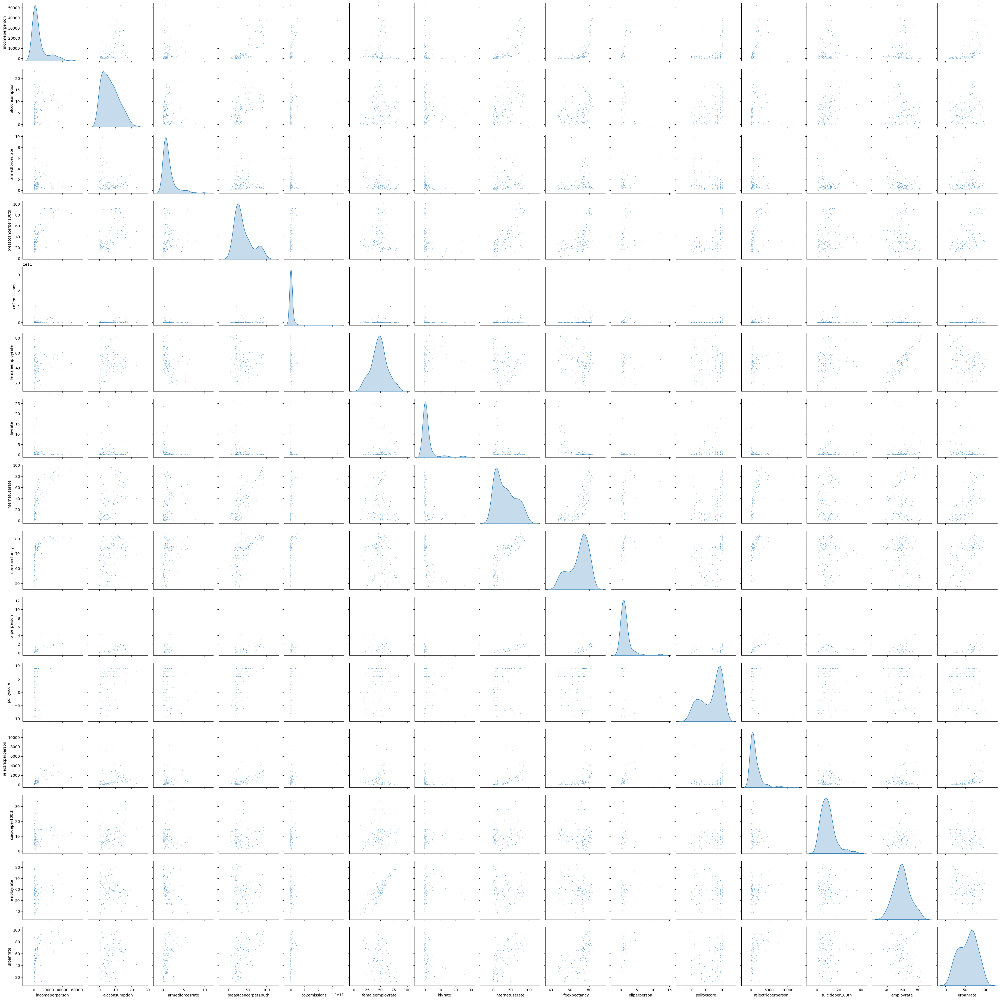

In [ ]:
sns.pairplot(
    df,
    diag_kind="kde",
    plot_kws={"s": 2, "alpha": 0.7},
);

Además, en las siguientes gráficas que presentan el top 40 de países donde una u otra variable es más alta o baja, se evidencia que las variables del TOP 6 claramente se correlacionan bien sea con países altamente desarrollados o países pobres, según sea el caso.

A continuación es posible observar que los países más ricos tienen tasas más altas de cancer de seno, esto porque tienen más mecanismos de detección.

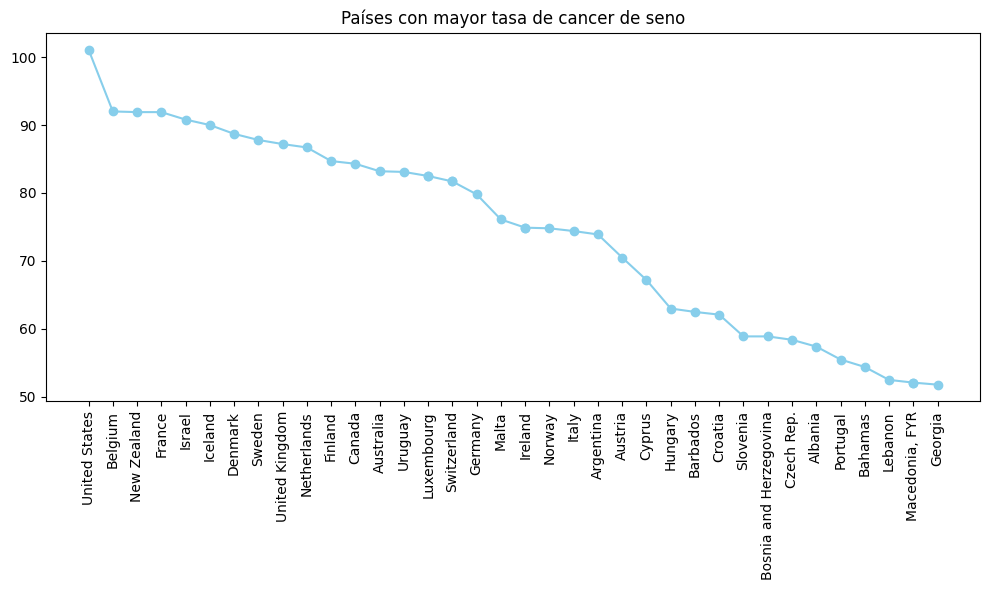

In [14]:
#countries = df.groupby('neighbourhood_cleansed')['breastcancerper100th'].mean()
countries = df.sort_values(by='breastcancerper100th', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["breastcancerper100th"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor tasa de cancer de seno')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

Los países considerados de primer mundo tienen mejor acceso a Internet para sus ciudadanos:

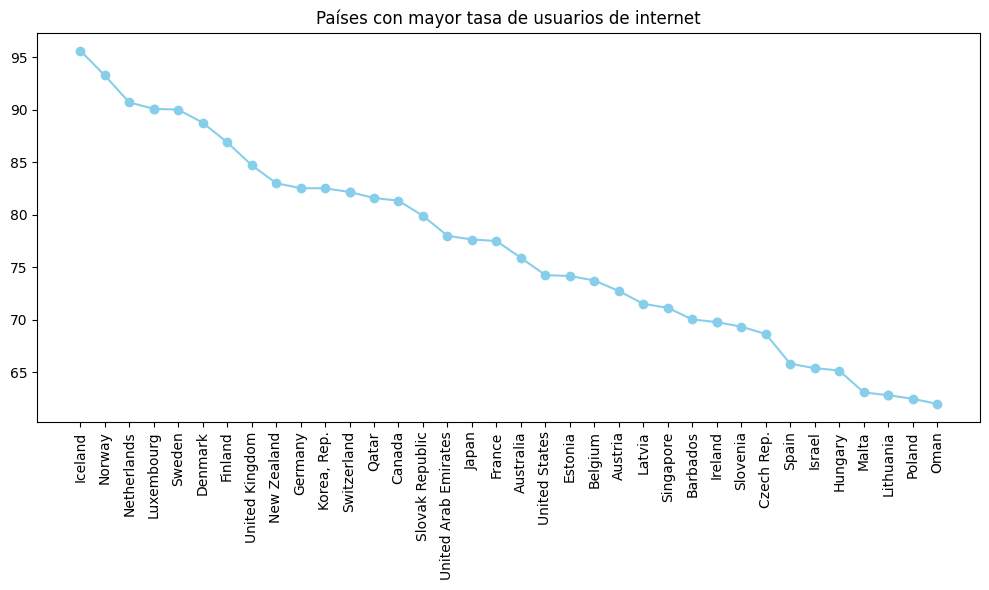

In [16]:
countries = df.sort_values(by='internetuserate', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["internetuserate"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor tasa de usuarios de internet')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

Claramente el nivel de desarrollo económico va ligado a la esperanza de vida:

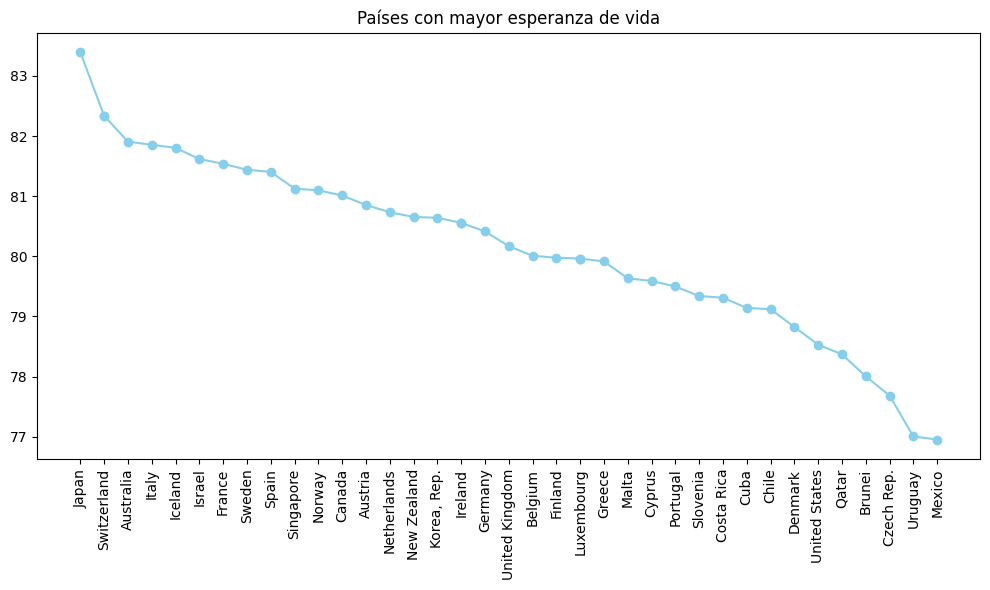

In [19]:
countries = df.sort_values(by='lifeexpectancy', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["lifeexpectancy"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor esperanza de vida')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

Los países más avanzados consumen más petroleo, y al mismo tiempo generan más emisiones. Destaca que grandes los productores de petroleo de Medio Oriente también son grandes consumidores per cápita.

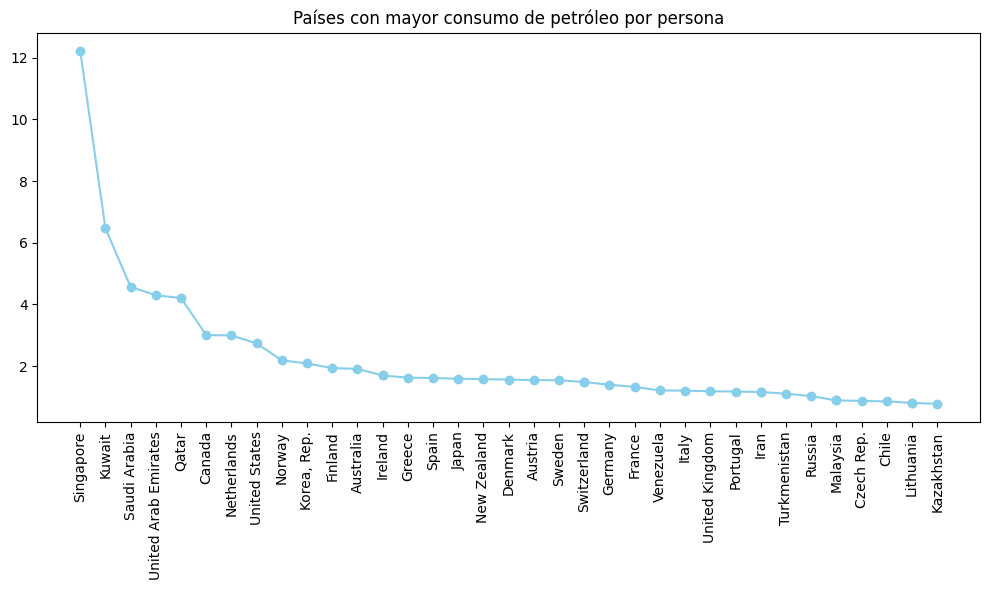

In [20]:
countries = df.sort_values(by='oilperperson', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["oilperperson"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor consumo de petróleo por persona')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

Nuevamente, y con alta correlación con el consumo de petroleo, no es sorpresa que los países más ricos consuman más energía eléctrica a nivel residencial.

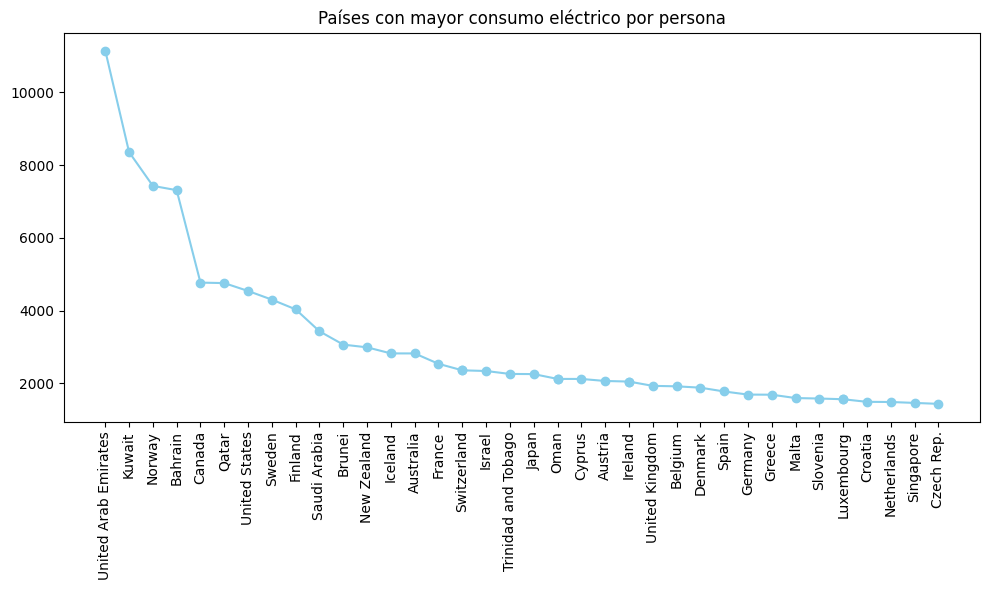

In [21]:
countries = df.sort_values(by='relectricperperson', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["relectricperperson"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor consumo eléctrico por persona')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

Si bien existe prevalencia de países desarrollados en el TOP 40 de % de población urbana, lo cierto es que destaca la presencia de algunos países de América Latina  y Africa en este top. Tal vez la población urbana no sea del todo un indicador confiable, pero la regresión tendrá la última palabra.

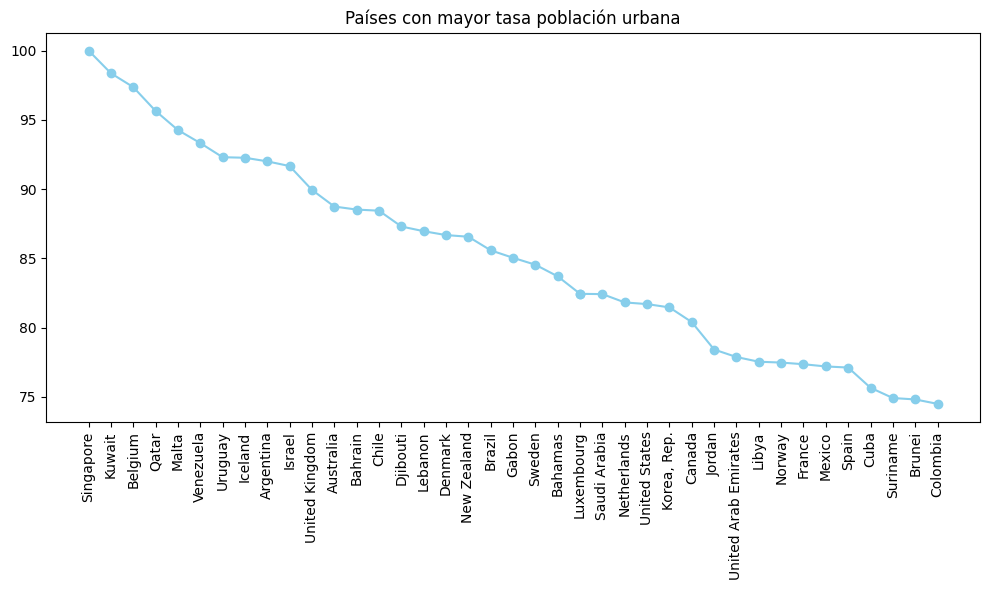

In [22]:
#countries = df.groupby('neighbourhood_cleansed')['breastcancerper100th'].mean()
countries = df.sort_values(by='urbanrate', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["urbanrate"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor tasa población urbana')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

El TOP 40 de los países con mayores tasas de VIH coincide con países pobres, especialmente de Africa:

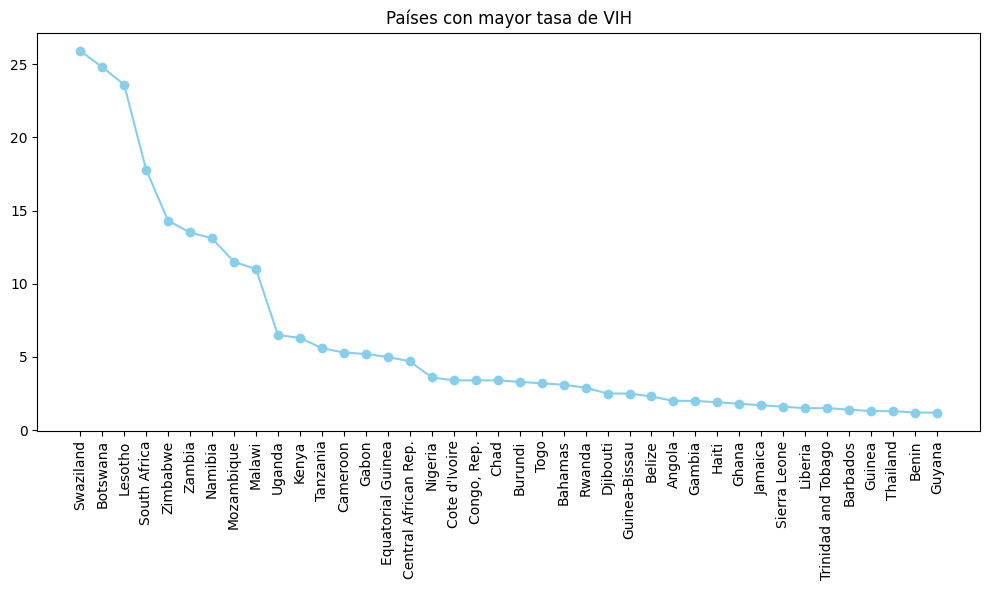

In [23]:
#countries = df.groupby('neighbourhood_cleansed')['breastcancerper100th'].mean()
countries = df.sort_values(by='hivrate', ascending=False)
countries = countries.head(40)

plt.figure(figsize=(10, 6))
plt.plot(countries["country"], countries["hivrate"], marker='o', color='skyblue', linestyle='-')
plt.title('Países con mayor tasa de VIH')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mejor legibilidad
plt.tight_layout()
plt.show()

# **3. Preparación de los datos**

**3.1. Análisis de calidad**

**Precisión:**

En lo relativo a esta dimensión, se ha verificado que la fuente de los datos "Gapminder" realizar compilados serios y rigurosos de la información socioeconómica de diferentes países. Por lo tanto, Gapminder constituye una fuente seria en la que se puede confiar. Además, el entendimiento de datos que se acaba de realizar muestra que, a nivel general, existe coherencia entre los datos y lo que de antemano se sabe del nivel de desarrollo de cada país. La siguiente gráfica de dispersión es una muestra de ello:

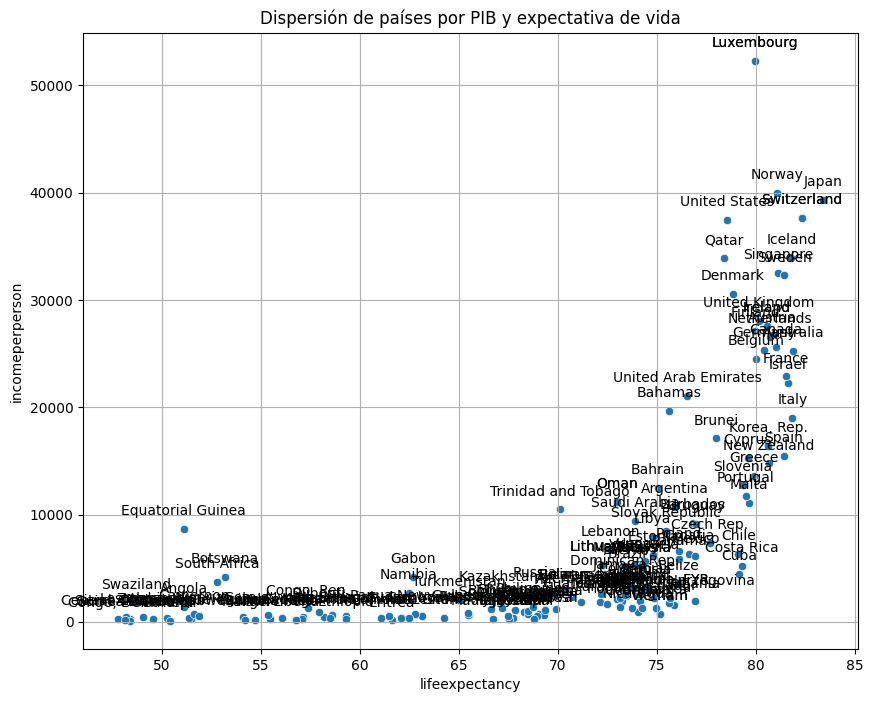

In [14]:
plt.figure(figsize=(10, 8))
sns.scatterplot(
    x=df["lifeexpectancy"],
    y=df["incomeperperson"]
)
plt.title("Dispersión de países por PIB y expectativa de vida")
plt.grid()
for i, row in df.iterrows():
    plt.annotate(row['country'], (row['lifeexpectancy'], row['incomeperperson']), textcoords="offset points", xytext=(0,10), ha='center')

plt.show()

**Completitud:**

Respecto a esta dimensión se tiene para cada una de las variables:

**-country:** 0% de los campos vacíos, sin problemas.

**-incomeperperson:**	3 campos vacíos (1,7%). Dado que esta es la variable que se quiere predecir, no es conveniente tener campos vacíos. Al ser tan pocos registros, estos se eliminarán. Además, dos de estos países son Afganistán y Myanmar, países sobre los que no existen datos confiables dada su complicada situación.

**-alcconsumption:** 0% de los campos vacíos, sin problemas.

**-armedforcesrate:** 4 campos vacíos (2.2%). Estos campos corresponden a Comoros, Solomon Islands, Bhutan y Swaziland, países que no tienen fuerzas militares activas, por lo que este campo se imputará como cero.

**-breastcancerper100th:** 1 campo vacío (0.6%). Este campo vacío corresponde a Timor-Leste. Este es un país muy pequeño y con muy poca relevancia a nivel internacional. Además, tiene otros campos relevantes vacíos también, por lo que se decide eliminarlo del dataset antes de la regresión.

**-co2emissions:** 2 campos vacíos (1,1%). Sin embargo, esta variable no se tendrá en cuenta en la regresión por sus problemas de consistencia: hace referencia a las emisiones totales, más no a las emisiones per cápita.

**-femaleemployrate:** 1 campo vacío (0,6%). Este campo pertenece a Djibouti, pequeño país de Africa. Además, este país contiene otros campos vacíos en el dataset y no es tan relevante a nivel mundial, por lo que el correspondiente registro se eliminará antes de la regresión.

**-hivrate:** 23 campos vacíos (12,9%). Esta es una de las variables más problemáticas aquí. Claramente, tener casi 13% de faltanes representa un problema importante de completitud de esta variable. Sin embargo, según lo visto en el entendimiento de datos, esta variable es importante para la regresión. Siendo así, se decide imputar esta variable según la región a la que pertenezca el respectivo país. En este caso, se identifican 4 regiones: Medio Oriente (0,2% de tasa de VIH), Africa Subsahariana (8%), Los Balcanes (0.06%) y Sudamérica(0,5%).

Para la imputación se tomará el promedio de tasa de infección por VIH para los demás países de la región que sí tienen datos.

**-internetuserate:** 4 campos vacíos (2,2%). Descontando un dato duplicado, son tres países los que carecen de datos sobre el acceso a Internet: Myanmar, el cual ya se había optado por eliminarlo de la regresión por su falta general de datos debido a sus problemas internos. Sudan, uno de los países más pobres del mundo, el cual se imputará con el promedio de países similares en su región: 2% de acceso a Internet. Y Sierra Leona, país africano pobre, pero no tan pobre como Sudan, el cual se imputará con los datos de otros países similares: 9% de acceso a Internet.

**-lifeexpectancy:** 0 campos vacíos, sin problema.

**-oilperperson:** 111 campos vacíos (62,4%). Esta variable simplemente tiene demasiados campos vacíos. Se decide dejarla por fuera de la regresión, puesto que no hay una forma coherente de imputar tantos datos.

**-polityscore:** 11 campos vacíos (6,2%). Aquí hay un dato duplicado para descontar. Aparte, hay 7 países con varios otros datos faltantes que se decide eliminar de la muestra; Bahamas, Barbados, Belice, Bosnia, Brunei, Cabo Verde y Surinam. Quedan entonces 3 países europeos (Islandia, Luxemburgo y Malta) conocidos por sus altos niveles de democracia, para los cuales se imputará un valor de 10, según el promedio de sus vecinos similares más cercanos.

**-relectricperperson:** 37 campos vacíos (20,8%). Lamentablemente, el nivel de campos vacíos de esta variable es muy grande como para imputarlo o ignorarlo. Así que no será posible usarla en la regresión. Sin embargo, durante el entendimiento de datos ya se comprobó que esta es una variable relevante para medir la riqueza de un país, lo cual ya genera insumos importantes a la hora de formular políticas públicas.

**-suicideper100th:** 0 campos vacíos, sin problemas.

**-employrate:** 1 campo vacío (0,6%). Este campo pertenece a Djibouti, país que igual se eliminará de la muestra por tener varios otros campos vacíos.

**-urbanrate:** 0 campos vacíos, sin problemas.

A continuación se deja el código que ejecuta esta limpieza de datos por completitud:


In [7]:
df_clean = df.dropna(subset=['incomeperperson'])

df_clean.loc[df_clean['country'] == 'Comoros', 'armedforcesrate'] = 0
df_clean.loc[df_clean['country'] == 'Solomon Islands', 'armedforcesrate'] = 0
df_clean.loc[df_clean['country'] == 'Bhutan', 'armedforcesrate'] = 0
df_clean.loc[df_clean['country'] == 'Swaziland', 'armedforcesrate'] = 0

df_clean = df_clean.dropna(subset=['breastcancerper100th'])

df_clean = df_clean.drop("co2emissions", axis=1)

df_clean = df_clean.dropna(subset=['femaleemployrate'])

df_clean.loc[df_clean['country'] == 'Afghanistan', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Bahrain', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Iraq', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Jordan', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Kuwait', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Saudi Arabia', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'United Arab Emirates', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Yemen, Rep.', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Syria', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Brunei', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Solomon Islands', 'hivrate'] = 0.2
df_clean.loc[df_clean['country'] == 'Congo, Dem. Rep.', 'hivrate'] = 8
df_clean.loc[df_clean['country'] == 'Ethiopia', 'hivrate'] = 8
df_clean.loc[df_clean['country'] == 'Cape Verde', 'hivrate'] = 8
df_clean.loc[df_clean['country'] == 'Libya', 'hivrate'] = 8
df_clean.loc[df_clean['country'] == 'Macedonia, FYR', 'hivrate'] = 0.06
df_clean.loc[df_clean['country'] == 'Bosnia and Herzegovina', 'hivrate'] = 0.06
df_clean.loc[df_clean['country'] == 'Turkmenistan', 'hivrate'] = 0.06
df_clean.loc[df_clean['country'] == 'Cyprus', 'hivrate'] = 0.06
df_clean.loc[df_clean['country'] == 'Albania', 'hivrate'] = 0.06
df_clean.loc[df_clean['country'] == 'Venezuela', 'hivrate'] = 0.5

df_clean.loc[df_clean['country'] == 'Sudan', 'internetuserate'] = 2
df_clean.loc[df_clean['country'] == 'Sierra Leone', 'internetuserate'] = 9

df_clean = df_clean.drop("oilperperson", axis=1)

df_clean.loc[df_clean['country'] == 'Iceland', 'polityscore'] = 10
df_clean.loc[df_clean['country'] == 'Luxembourg', 'polityscore'] = 10
df_clean.loc[df_clean['country'] == 'Malta', 'polityscore'] = 10
df_clean = df_clean.dropna(subset=['polityscore'])

df_clean = df_clean.drop("relectricperperson", axis=1)

df_clean.shape



(166, 13)

**Consistencia:**

Como ya se hizo en las líneas anteriores, la variable de emisiones acumuladas de CO2 se ha eliminado por falta de consistencia. Esta variable correspondía al estimado total por país, más no a un estimado per cápita como el resto de variables. Por esta razón, las emisiones totales de países como China y USA no son comparables, teniendo en cuenta que China tiene una población mucho mayor.

Por otra parte, las demás variables resultan ser consistentes con el objetivo del ejercicio. Solamente, se ha evidenciado que existen 12 registros duplicados, los cuales se procede a eliminar:

In [8]:
df_clean = df_clean.drop_duplicates()
df_clean.shape

(154, 13)

In [9]:
df_clean.head(10)

,country,incomeperperson,alcconsumption,armedforcesrate,breastcancerper100th,femaleemployrate,hivrate,internetuserate,lifeexpectancy,polityscore,suicideper100th,employrate,urbanrate
0,Ireland,27595.091350,14.92,0.450024,74.9,51.000000,0.20,69.770394,80.557,10.0,10.365070,59.900002,61.34
1,Albania,1914.996551,7.29,1.024736,57.4,42.099998,0.06,44.989947,76.918,9.0,7.699330,51.400002,46.72
2,Central African Rep.,239.518749,3.17,0.148659,16.5,62.900002,4.70,2.300027,48.398,-1.0,13.548420,71.300003,38.58
4,Italy,18982.269290,9.72,1.729346,74.4,35.799999,0.30,53.740217,81.855,10.0,4.930045,46.400002,68.08
5,Switzerland,37662.751250,11.41,0.524220,81.7,57.000000,0.40,82.166660,82.338,10.0,13.239810,64.300003,73.48
6,Mauritania,609.131206,0.11,1.551262,28.1,45.299999,0.70,2.999803,58.582,-2.0,6.882952,46.900002,41.00
7,Oman,11191.811010,0.92,4.465998,13.2,22.600000,0.10,61.987413,72.974,-8.0,3.716739,50.700001,71.62
8,Tanzania,456.385712,7.86,0.134730,21.1,76.099998,5.60,11.000055,58.199,-1.0,12.411181,78.199997,25.52
9,Thailand,2712.517199,7.08,1.093651,16.6,65.000000,1.30,21.200072,74.126,4.0,9.847460,72.000000,33.32
10,Haiti,371.424197,5.92,0.000000,4.4,35.400002,1.90,8.370207,62.095,5.0,1.519248,55.900002,46.84


**Oportunidad (A tiempo):**

Existe aquí un aspecto importante sobre la oportunidad temporal de los datos. Y este se trata de que una buena parte de las variables no son del mismo año. Concretamente, se desea predecir el PIB per Cápita de un país en 2010, con base en variables que fueron tomadas en diferentes años entre el 2006 y el 2011.

Sin embargo, se considera que en este caso es válido pasar por alto esto, puesto que en todos los casos se trata de datos de la misma década, que da una u otra forma reflejan la realidad del cada país hacia 2010. Además, la verdad es que los cambios socioeconómicos no suelen suceder tan rápido, como para que un país cambie demasiado en unos 5 años.

Por lo tanto, para efectos de este ejercicio se considerará como válida la mezcla entre diferentes variables que difieren levemente en su año de muestreo, pero que de todas formas no están a más de 5 años entre sí.

**Conformidad y validez:**

Se ha revisado el dataset, y todas las columnas tienen valores que son conformes a su especificación, en los formatos adecuados. Además, los datos resultan ser válidos dentro de su domino del conocimiento.

**Relevancia:**

Durante el proceso de entendimiento de datos se ha demostrado que las variables del dataset son relevantes para la regresión propuesta, particularmente aquellas escogidas dentro del TOP 6.

**Procesabilidad:**

Aquí se está tratando con un dataset relativamente sencillo, que después de depurarse contiene 154 filas x 13 columnas. La primera columna contiene nombres de países, mientras que las otras 12 contienen datos númericos (FLoat) fáciles de tratar. Por lo tanto, no hay ningún problema para procesar esta dataset.

**Disponibilidad:**

Por defecto, al haber descargado el dataset desde el repositorio enunciado, los datos necesarios para este ejercicio ya se encuentran disponibles.

Con el objetivo de hacer una última revisión sobre los datos procesados, se vuelve a ejecutar ProfileReport sobre el dataset depurado. Es posible observar que este nuevo dataset ya cumple entonces con todas las dimensiones de calidad de datos.

**3.2. Complementación de los datos con fuentes externas**

De manera adicional, y con el fin de enriquecer el dataset, se ha buscado información adicional que permita complementar los datos. Concretamente, se utilizarán datos extraídos de Gapminder con la región geográfica de cada país (esquema de 8 regiones) y el nivel de ingresos con el cual el Banco Mundial clasifica a cada país (Ingresos altos, medio altos, medio bajos, bajos).

Se carga entonces el nuevo dataset y se procede a mezclarlo con el dataset base que se viene usando:

In [10]:
# Loading the CSV file as dataframe
geo_df = pd.read_csv("./Data_geo.csv", delimiter=';')
geo_df.shape

(197, 3)

In [11]:
geo_df

,name,eight_regions,"World bank, 4 income groups 2017"
0,Australia,east_asia_pacific,High income
1,Brunei,east_asia_pacific,High income
2,Cambodia,east_asia_pacific,Lower middle income
3,China,east_asia_pacific,Upper middle income
4,Fiji,east_asia_pacific,Upper middle income
...,...,...,...
192,Uganda,africa_sub_saharan,Low income
193,Zambia,africa_sub_saharan,Lower middle income
194,Zimbabwe,africa_sub_saharan,Low income
195,South Sudan,africa_sub_saharan,Low income


In [12]:
df_clean = pd.merge(df_clean, geo_df, left_on="country", right_on="name")
df_clean = df_clean.drop("name", axis=1)
df_clean

,country,incomeperperson,alcconsumption,armedforcesrate,breastcancerper100th,femaleemployrate,hivrate,internetuserate,lifeexpectancy,polityscore,suicideper100th,employrate,urbanrate,eight_regions,"World bank, 4 income groups 2017"
0,Ireland,27595.091350,14.92,0.450024,74.9,51.000000,0.20,69.770394,80.557,10.0,10.365070,59.900002,61.34,europe_west,High income
1,Albania,1914.996551,7.29,1.024736,57.4,42.099998,0.06,44.989947,76.918,9.0,7.699330,51.400002,46.72,europe_east,Upper middle income
2,Italy,18982.269290,9.72,1.729346,74.4,35.799999,0.30,53.740217,81.855,10.0,4.930045,46.400002,68.08,europe_west,High income
3,Switzerland,37662.751250,11.41,0.524220,81.7,57.000000,0.40,82.166660,82.338,10.0,13.239810,64.300003,73.48,europe_west,High income
4,Mauritania,609.131206,0.11,1.551262,28.1,45.299999,0.70,2.999803,58.582,-2.0,6.882952,46.900002,41.00,africa_sub_saharan,Lower middle income
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,Mexico,6105.280743,8.55,0.612340,26.4,39.599998,0.30,31.050013,76.954,8.0,4.288574,57.900002,77.20,america_north,Upper middle income
143,Mauritius,5182.143721,3.53,0.349544,31.6,36.299999,1.00,28.731883,73.373,10.0,8.081540,54.500000,42.48,africa_sub_saharan,Upper middle income
144,Namibia,2667.246710,12.09,1.972913,24.7,37.299999,13.10,6.500823,62.465,6.0,8.021970,42.000000,36.84,africa_sub_saharan,Upper middle income
145,Comoros,336.368749,0.28,0.000000,19.5,59.299999,0.10,5.098265,61.061,9.0,4.751084,68.000000,28.08,africa_sub_saharan,Low income


In [13]:
ydata_profiling.ProfileReport(df_clean)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Dado que las dos nuevas variables son categóricas, será necesario transformarlas para incorporarlas en la regresión. En el caso de la variable que indica una de las 8 regiones geográficas, se utilizará un one hot encoder. Para el nivel de ingresos según el Banco Mundial, se utilizará una categorización ordinal:

In [14]:
df_clean.loc[df_clean['World bank, 4 income groups 2017'] == 'High income', 'World bank, 4 income groups 2017'] = 4
df_clean.loc[df_clean['World bank, 4 income groups 2017'] == 'Upper middle income', 'World bank, 4 income groups 2017'] = 3
df_clean.loc[df_clean['World bank, 4 income groups 2017'] == 'Lower middle income', 'World bank, 4 income groups 2017'] = 2
df_clean.loc[df_clean['World bank, 4 income groups 2017'] == 'Low income', 'World bank, 4 income groups 2017'] = 1

In [15]:
df_clean = pd.get_dummies(df_clean, columns=["eight_regions"])
df_clean ["eight_regions_africa_north"] = df_clean ["eight_regions_africa_north"].astype(float)
df_clean ["eight_regions_africa_sub_saharan"] = df_clean ["eight_regions_africa_sub_saharan"].astype(float)
df_clean ["eight_regions_america_north"] = df_clean ["eight_regions_america_north"].astype(float)
df_clean ["eight_regions_america_south"] = df_clean ["eight_regions_america_south"].astype(float)
df_clean ["eight_regions_asia_west"] = df_clean ["eight_regions_asia_west"].astype(float)
df_clean ["eight_regions_east_asia_pacific"] = df_clean ["eight_regions_east_asia_pacific"].astype(float)
df_clean ["eight_regions_europe_east"] = df_clean ["eight_regions_europe_east"].astype(float)
df_clean ["eight_regions_europe_west"] = df_clean ["eight_regions_europe_west"].astype(float)
df_clean

,country,incomeperperson,alcconsumption,armedforcesrate,breastcancerper100th,femaleemployrate,hivrate,internetuserate,lifeexpectancy,polityscore,suicideper100th,employrate,urbanrate,"World bank, 4 income groups 2017",eight_regions_africa_north,eight_regions_africa_sub_saharan,eight_regions_america_north,eight_regions_america_south,eight_regions_asia_west,eight_regions_east_asia_pacific,eight_regions_europe_east,eight_regions_europe_west
0,Ireland,27595.091350,14.92,0.450024,74.9,51.000000,0.20,69.770394,80.557,10.0,10.365070,59.900002,61.34,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,Albania,1914.996551,7.29,1.024736,57.4,42.099998,0.06,44.989947,76.918,9.0,7.699330,51.400002,46.72,3,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,Italy,18982.269290,9.72,1.729346,74.4,35.799999,0.30,53.740217,81.855,10.0,4.930045,46.400002,68.08,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,Switzerland,37662.751250,11.41,0.524220,81.7,57.000000,0.40,82.166660,82.338,10.0,13.239810,64.300003,73.48,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,Mauritania,609.131206,0.11,1.551262,28.1,45.299999,0.70,2.999803,58.582,-2.0,6.882952,46.900002,41.00,2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,Mexico,6105.280743,8.55,0.612340,26.4,39.599998,0.30,31.050013,76.954,8.0,4.288574,57.900002,77.20,3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
143,Mauritius,5182.143721,3.53,0.349544,31.6,36.299999,1.00,28.731883,73.373,10.0,8.081540,54.500000,42.48,3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
144,Namibia,2667.246710,12.09,1.972913,24.7,37.299999,13.10,6.500823,62.465,6.0,8.021970,42.000000,36.84,3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
145,Comoros,336.368749,0.28,0.000000,19.5,59.299999,0.10,5.098265,61.061,9.0,4.751084,68.000000,28.08,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


# **4. Modelo de regresión**

Se procede a continuación con el modelo de regresión con el cual se buscaría predecir el PIB per Cápita de un país, con base en los otros indicadores contenidos en el dataset.

Para esto, en primer lugar, se crearán los respectivos vectores X y Y, a la vez que se estandarizarán los valores X antes de usarlos en la regresión.

In [16]:
X = df_clean.drop("country", axis=1)
X = X.drop("incomeperperson", axis=1)
Y = df_clean['incomeperperson']  # Variable objetivo

#  Normalizar los datos de entrada
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

Se procede ahora a crear los conjuntos de entrenamiento y test, usando la regla de 80-20:

In [17]:
#Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, Y_train, Y_test = train_test_split(X_scaled, Y, test_size=0.2, random_state=42)

**4.1. Regresión lineal**

Y se entrena el modelo:

In [18]:
#Crear y entrenar el modelo de regresión lineal
model = LinearRegression()
model.fit(X_train, Y_train)

LinearRegression()

Y se evalúa ahora con los datos de test:

In [19]:
#Evaluar el modelo con el conjunto de prueba
Y_pred = model.predict(X_test)
mse = mean_squared_error(Y_test, Y_pred)
r2 = r2_score(Y_test, Y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"R-squared (R2): {r2}")

Mean Squared Error (MSE): 20722999.279324375
R-squared (R2): 0.6485335322488124


Por último, se extraen los coeficientes del modelo de regresión lineal:

In [44]:
model.coef_

array([ -943.63205799,  -245.34128827,  2437.7450968 ,   616.59937555,
        1118.9893151 ,  7280.02037928,  2326.87892788,  -284.42895293,
         631.00215295,  1091.8947536 ,  1059.7854896 ,   265.96647405,
          37.72657713,  1690.44887663,   156.204582  , -1291.15458236,
         139.55507731,   280.33246848, -2319.83416895,   544.04430406])

In [45]:
print("Coeficientes de la regresión lineal:")
print("alcconsumption: " + str(model.coef_[0]))
print("armedforcesrate: " + str(model.coef_[1]))
print("breastcancerper100th: " + str(model.coef_[2]))
print("femaleemployrate: " + str(model.coef_[3]))
print("hivrate: " + str(model.coef_[4]))
print("internetuserate: " + str(model.coef_[5]))
print("lifeexpectancy: " + str(model.coef_[6]))
print("polityscore: " + str(model.coef_[7]))
print("suicideper100th: " + str(model.coef_[8]))
print("employrate: " + str(model.coef_[9]))
print("urbanrate: " + str(model.coef_[10]))
print("World bank, 4 income groups 2017: " + str(model.coef_[11]))
print("eight_regions_africa_north: " + str(model.coef_[12]))
print("eight_regions_africa_sub_saharan: " + str(model.coef_[13]))
print("eight_regions_america_north: " + str(model.coef_[14]))
print("eight_regions_america_south: " + str(model.coef_[15]))
print("eight_regions_asia_west: " + str(model.coef_[16]))
print("eight_regions_east_asia_pacific: " + str(model.coef_[17]))
print("eight_regions_europe_east: " + str(model.coef_[18]))
print("eight_regions_europe_west: " + str(model.coef_[19]))
print("intercept: " + str(model.intercept_))

Coeficientes de la regresión lineal:
alcconsumption: -943.6320579898855
armedforcesrate: -245.34128827349105
breastcancerper100th: 2437.745096797727
femaleemployrate: 616.5993755513317
hivrate: 1118.9893150961825
internetuserate: 7280.020379280859
lifeexpectancy: 2326.878927880945
polityscore: -284.4289529280069
suicideper100th: 631.0021529494929
employrate: 1091.8947535976783
urbanrate: 1059.7854895977134
World bank, 4 income groups 2017: 265.9664740493914
eight_regions_africa_north: 37.726577131974125
eight_regions_africa_sub_saharan: 1690.4488766349468
eight_regions_america_north: 156.20458200018567
eight_regions_america_south: -1291.1545823593037
eight_regions_asia_west: 139.55507731311786
eight_regions_east_asia_pacific: 280.33246848382817
eight_regions_europe_east: -2319.8341689548515
eight_regions_europe_west: 544.0443040587661
intercept: 7545.424951708311


Se ha obtenido un R2 de casi 0,65. Este número está un poco por debajo de lo que se esperaba, por lo que se intentará con una regresión con regularización Lasso para comparar:

**4.2. Regresión Lasso**

Para resta regresión se ha probado manualmente con varios valores del hiperparámetro alpha, encontrando que con 800 se encontró el mejor ajuste con los datos de validación.

In [68]:
# Crear y entrenar el modelo de regresión Lasso
alpha = 300
lasso_model = Lasso(alpha=alpha)
lasso_model.fit(X_train, Y_train)

# Evaluar el modelo Lasso con el conjunto de prueba
Y_pred = lasso_model.predict(X_test)
mse = mean_squared_error(Y_test, Y_pred)
r2 = r2_score(Y_test, Y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"R-squared (R2): {r2}")

Mean Squared Error (MSE): 15885429.22747667
R-squared (R2): 0.7305797474565792


In [69]:
print("Coeficientes de la regresión Lasso:")
print("alcconsumption: " + str(lasso_model.coef_[0]))
print("armedforcesrate: " + str(lasso_model.coef_[1]))
print("breastcancerper100th: " + str(lasso_model.coef_[2]))
print("femaleemployrate: " + str(lasso_model.coef_[3]))
print("hivrate: " + str(lasso_model.coef_[4]))
print("internetuserate: " + str(lasso_model.coef_[5]))
print("lifeexpectancy: " + str(lasso_model.coef_[6]))
print("polityscore: " + str(lasso_model.coef_[7]))
print("suicideper100th: " + str(lasso_model.coef_[8]))
print("employrate: " + str(lasso_model.coef_[9]))
print("urbanrate: " + str(lasso_model.coef_[10]))
print("World bank, 4 income groups 2017: " + str(lasso_model.coef_[11]))
print("eight_regions_africa_north: " + str(lasso_model.coef_[12]))
print("eight_regions_africa_sub_saharan: " + str(lasso_model.coef_[13]))
print("eight_regions_america_north: " + str(lasso_model.coef_[14]))
print("eight_regions_america_south: " + str(lasso_model.coef_[15]))
print("eight_regions_asia_west: " + str(lasso_model.coef_[16]))
print("eight_regions_east_asia_pacific: " + str(lasso_model.coef_[17]))
print("eight_regions_europe_east: " + str(lasso_model.coef_[18]))
print("eight_regions_europe_west: " + str(lasso_model.coef_[19]))
print("intercept: " + str(lasso_model.intercept_))

Coeficientes de la regresión Lasso:
alcconsumption: -0.0
armedforcesrate: -0.0
breastcancerper100th: 2205.375886346924
femaleemployrate: 0.0
hivrate: 476.98851062744274
internetuserate: 7945.076770828324
lifeexpectancy: 0.0
polityscore: -0.0
suicideper100th: 0.0
employrate: 1026.254473851898
urbanrate: 211.86508278003666
World bank, 4 income groups 2017: 380.6431230360768
eight_regions_africa_north: -0.0
eight_regions_africa_sub_saharan: 0.0
eight_regions_america_north: -0.0
eight_regions_america_south: -1069.7753863207788
eight_regions_asia_west: -0.0
eight_regions_east_asia_pacific: 0.0
eight_regions_europe_east: -2791.993527142519
eight_regions_europe_west: 197.82014654650618
intercept: 7476.800795637643


Con la regresión Lasso ha mejorado el R2, 0.73. Se considera que este es un valor útil para los intereses del ejercicio, y por lo tanto se tomará esta regresión lasso para realizar el análisis de coeficientes y generar las conclusiones de este taller.

(Estas conclusiones se presentarán en el respectivo informe anexo, este notebook llega hasta aquí)